In [1]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters,
                   hexagon_parameters)

In [3]:
kdata = make_k(-23)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)

In [4]:
alphas = precomputed_alphas(k)
M_alphas, alpha_inv = make_M_alphas(alphas)

#assert alphas == [cusp(zero), cusp((w+1)/2), cusp(5/(2*w)), cusp(-5/(2*w))]

sigmas = singular_points_new(k)
assert sigmas == [inf, cusp((w-1)/2), cusp(w/2)]


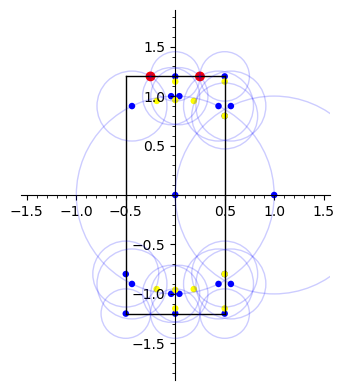

In [5]:
plot_FunDomain_projection(k, alphas, sigmas)

In [6]:
polys, hemis = all_polyhedra(k)
print("{} polyhedra constructed".format(len(polys)))

New orbit from P_0=[-73/184*w + 1/92, 11/184]: {0, 3, 5, 6}
New orbit from P_1=[73/184*w - 1/92, 11/184]: {1, 2, 4, 7}
New orbit from P_8=[2/5*w - 1/5, 2/25]: {8, 9}
New orbit from P_10=[1/3*w + 1/3, 1/9]: {10, 11}
Found [[8, 9], [10, 11], [1, 2, 4, 7], [0, 3, 5, 6]] orbits:
Constructed 4 polyhedra
Faces: [[3, 3, 3, 3], [4, 4, 3, 4, 3], [3, 3, 3, 3], [3, 3, 3, 3]]
New orbit from R_0=[23/48*w - 35/48, 23/384]: {0, 3, 5}
New orbit from R_1=[25/48*w - 3/4, 23/384]: {1, 2, 4}
Found 2 orbits with representative points [[1, 2, 4], [0, 3, 5]]:
Constructed 2 polyhedra
Faces: [[3, 3, 3, 3], [3, 3, 3, 3]]
New orbit from R_0=[23/48*w + 1/4, 23/384]: {0, 3, 4}
New orbit from R_1=[25/48*w + 11/48, 23/384]: {1, 2, 5}
Found 2 orbits with representative points [[0, 3, 4], [1, 2, 5]]:
Constructed 2 polyhedra
Faces: [[3, 3, 3, 3], [3, 3, 3, 3]]
8 polyhedra constructed


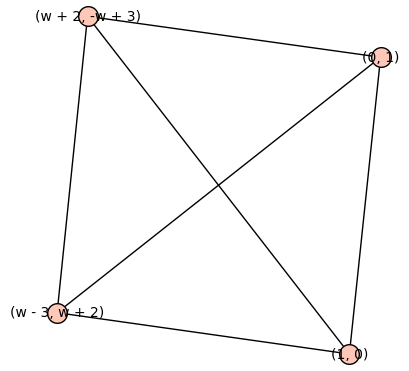

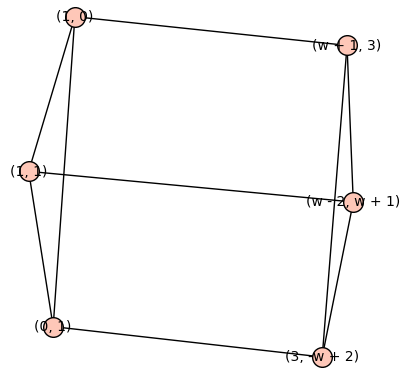

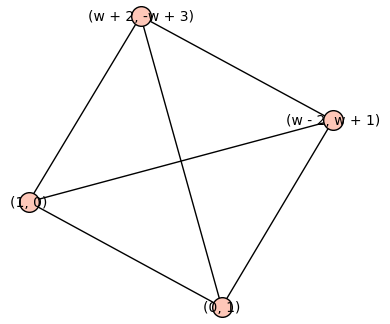

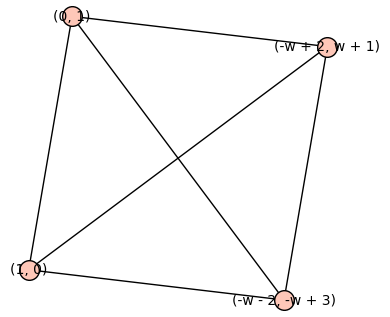

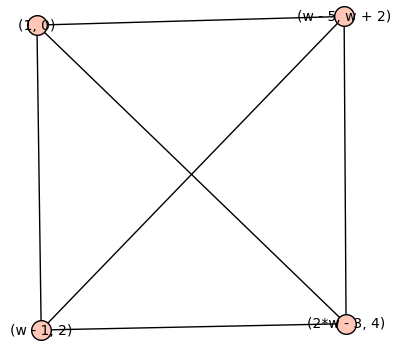

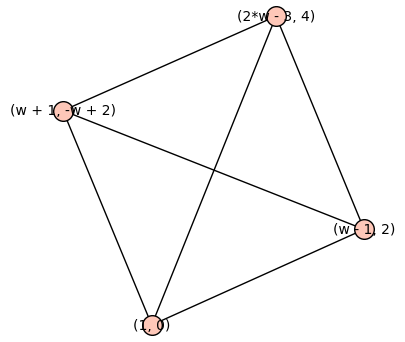

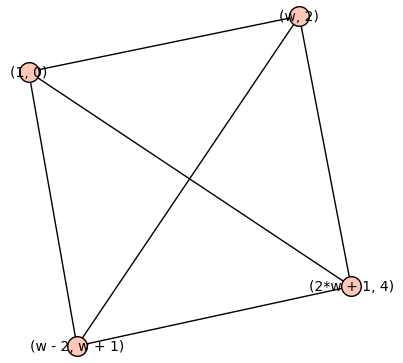

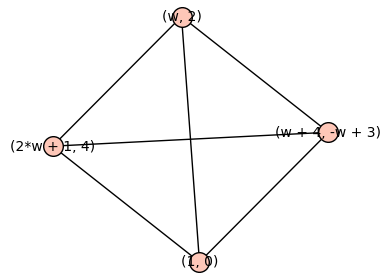

In [7]:
assert len(polys)==8
for G in polys: show(G)

In [8]:
triangles = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [9]:
[len(t) for t in [aaa_triangles, aas_triangles, squares, hexagons]]

[18, 12, 3, 0]

In [10]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
aas_triangles0 = aas_triangle_gl2_orbit_reps(aas_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [11]:
[len(t) for t in [aaa_triangles0, aas_triangles0, squares0, hexagons0]]

[5, 6, 1, 0]

In [12]:
[square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

[[[3, 0, 4, 0], [0, 0, 1]]]

In [13]:
[aas_triangle_parameters(T, alphas, M_alphas, sigmas) for T in aas_triangles0]

[[[7, 1, 1], 0],
 [[10, 1, 1], -w + 1],
 [[2, 1, 1], -w],
 [[6, 2, 2], 0],
 [[11, 2, 2], -w],
 [[2, 2, 2], -w]]

In [14]:
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1

[[[-w - 2:w - 3], oo, [-w + 3:-w - 2]],
 [[-w - 1:w - 2], oo, [0:1]],
 [[-w + 2:-w - 1], oo, [w + 2:-w + 3]],
 [[2*w + 1:4], oo, [2*w - 3:w + 2]]]

In [15]:
[aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

[[12, 9, 0], [7, 0, 5], [6, 12, 2], [9, 7, 1]]

In [16]:
[hexagon_parameters(H, alphas, M_alphas) for H in hexagons0]

[]

In [17]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object

In [18]:
from polyhedra import all_poly_types, poly_types

In [19]:
poly_types(polys)

{'tetrahedron': 7,
 'cube': 0,
 'triangular prism': 1,
 'square prism': 0,
 'hexagonal prism': 0,
 'hexagonal cap': 0,
 'truncated tetrahedron': 0,
 'cuboctahedron': 0}

In [20]:
all_poly_types(polys)

['tetrahedron',
 'triangular prism',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron']